In [50]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.constants import N_A
import pints
from scipy.integrate import solve_ivp
import pints.plot
sns.set_context('talk')

In [51]:
Target_cell_number = 2e4
well_size = 50e-6
sigma = well_size*N_A/Target_cell_number
tumour_cell_radius = 7.25e-6
receptor_quant = {'500G_F': 11902, 'MSX_B':1713701, '500G_B':123366, '500G_L':2831,
                  '250G_A':124222, '250G_C': 91578, 'MSX_A': 1843343, 'MSX_C':1584638,
                  'MSX_D': 2158, 'MSX_E': 2478, 'MSX_F': 17469, '500G_A': 120454,
                  '500G_C': 107181, '500G_D': 9824, '500G_E': 6719, '500G_H': 6341,
                  '500G_I': 8195, '500G_J': 7960, '500G_K': 2174, 'MSX_I': 52886}
parameter_names=[r'$k_{on}$', r'$K_D$', r'$k_2$', 'C', 'noise1', 'noise2']
t_end = 60*60*1
t = np.geomspace(1e-10, t_end, 50)
tspan = [1e-10, t_end]

In [52]:
def model_eqns(t, z, kon, KD, k2, rtot, Ainit):
    Atot = Ainit*sigma
    k1 = kon/sigma
    A0 = Atot - z[0] - z[1]
    r = rtot - z[0] - 2*z[1]

    dA1 = 2*k1*r*A0 - (KD*kon)*z[0] - k2*r*z[0] + 2*(KD*kon)*z[1]
    dA2 = k2*z[0]*r - 2*(KD*kon)*z[1]

    return [dA1, dA2]


def solve_model_individual(kon, KD, k2, rtot, A0s):
    solution = np.zeros_like(A0s)
    z0 = [0, 0]
    for i, Ainit in enumerate(A0s):
        z = solve_ivp(model_eqns, tspan, z0, method='Radau', t_eval=t, args=(kon, KD, k2, rtot, Ainit))
        A1 = z.y[0]
        A2 = z.y[1]
        bound_ab = A1[-1] + A2[-1]
        solution[i] = bound_ab
    
    return solution

def simulate_model(A0s, parameters, rtot):

    kon = parameters[0]
    kon = 10**kon
    KD = parameters[1]
    KD = 10**KD
    k2 = parameters[2]
    k2 = 10**k2
    C = parameters[3]
    C=10**C
    b = parameters[4]
    b = 10**b
    solution = np.zeros((len(A0s), 2))
    solution[:, 0] = (solve_model_individual(kon, KD, 0, rtot, A0s))
    solution[:, 1] = (solve_model_individual(kon, KD, k2, rtot, A0s))

    return C*solution + b


In [53]:
df = pd.read_excel(r'/Users/lukeheirene/ADCC-Project/GSK_mono_biv_project/Data/RE_ Mono vs Bivalent cell binding data - high affinity Ab/ELN340091_Tabular.xlsx')
df = df.dropna(subset=['CELL_ID']).reset_index(drop=True)

In [54]:
def data_extractor(df, cell_id, antibody_id):

    detect_id = 'RL-2'
    df1 = df.query('CELL_ID==@cell_id & ANTIBODY_ID==@antibody_id & DETECTOR==@detect_id')
    mono_df = df1.query('ANTIBODY_FORMAT=="MONOVALENT"')
    biv_df = df1.query('ANTIBODY_FORMAT=="BIVALENT"')

    concs = list(np.flip(mono_df['ANTIBODY_CONCENTRATION_MOLAR'].values))
    response_mono = list(np.flip(mono_df['RESPONSE'].values))
    response_biv = list(np.flip(biv_df['RESPONSE'].values))
    
    return response_mono, response_biv, concs

In [55]:
def mcmc_alg(cell_id, antibody_id, conc_data, mono_data, biv_data):
    
    #setup data
    data = np.stack((mono_data, biv_data), axis=1)
    #max = np.max(data)
    #data = (data - 2500)
    rtot = receptor_quant[cell_id]
    

    #remove cho cell measured background from expression
    rtot = rtot - 2000
    data = data/rtot
    
    class model(pints.ForwardModel):

        def n_outputs(self):
         return 2
    
        def n_parameters(self):
         return 5
    
        def simulate(self, parameters, A0s):
         sim = simulate_model(A0s, parameters, rtot) 
         return sim/rtot
        

    #setup prior and posteriors
    mod = model()
    problem = pints.MultiOutputProblem(mod, conc_data, data)
    log_likelihood = pints.GaussianLogLikelihood(problem)
    #parameters = [5.8, -8, -4, 1, 0.2, 0.2]
    #log_prior = pints.UniformLogPrior(
    #    [4, -12, -11, -1, 0.01, 0.01],
    #    [7, -5, -2.5, 2, 1, 1]
    #)
    parameters = [5.8, -8, -4,  1,  3, 0.2, 0.2]
    log_prior = pints.UniformLogPrior(
    [4, -12, -8, -1, 2, 0.01, 0.01],
    [7, -6, -1, 2, 4, 1, 1]
    )
    log_posterior = pints.LogPosterior(log_likelihood, log_prior)

    #setup mcmc
    xs = [
        np.array(parameters) * 0.85,
        np.array(parameters) * 0.95,
        np.array(parameters) * 1.05,
        np.array(parameters) * 1.15 
        ]
    mcmc = pints.MCMCController(log_posterior, 4, xs)
    mcmc.set_max_iterations(15000)
    chains = mcmc.run()

    chain = chains[0]
    chain = chain[10000:]
    chains1 = chains[:, 10000 :]
    fig, axes = pints.plot.series(chains1[0], problem)

    plt.legend()
    plt.xscale('log')
    plt.xlabel(r'Antibody Concentration')
    parameter_names=[r'$k_{on}$', r'$K_D$', r'$k_2$', 'C', 'b', 'noise1', 'noise2']
    results = pints.MCMCSummary(chains=chains1, time=mcmc.time(),parameter_names=parameter_names)
    print(results)

    return chains, results   

MSX_I
52886
Using Haario-Bardenet adaptive covariance MCMC
Generating 4 chains.
Running in sequential mode.
Iter. Eval. Accept.   Accept.   Accept.   Accept.   Time m:s
0     4      0         0         0         0          0:00.3
1     8      0.5       0         0.5       0.5        0:00.6
2     12     0.667     0         0.333     0.333      0:00.9
3     16     0.75      0         0.25      0.25       0:01.2
20    84     0.381     0.381     0.333     0.381      0:05.7
40    164    0.268     0.317     0.293     0.293      0:10.7
60    244    0.213     0.262     0.213     0.23       0:16.3
80    324    0.21      0.235     0.222     0.222      0:21.9
100   404    0.198     0.188     0.198     0.188      0:27.2
120   484    0.174     0.165     0.174     0.157      0:32.6
140   564    0.177305  0.149     0.149     0.135      0:37.7
160   644    0.161     0.13      0.13      0.118      0:42.6
180   724    0.155     0.116     0.116     0.105      0:47.6
Initial phase completed.
200   804    

/Users/lukeheirene/ADCC-Project/GSK_mono_biv_project/inf_env/lib/python3.12/site-packages/pints/plot/_series.py:94: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(n_outputs, 1, figsize=(8, np.sqrt(n_outputs) * 3),


param     mean    std.    2.5%    25%    50%    75%    97.5%    rhat    ess     ess per sec.
--------  ------  ------  ------  -----  -----  -----  -------  ------  ------  --------------
$k_{on}$  5.03    0.65    4.05    4.49   5.00   5.49   6.38     1.01    610.54  0.28
$K_D$     -6.39   0.23    -6.98   -6.50  -6.36  -6.24  -6.05    1.01    608.97  0.28
$k_2$     -2.11   0.75    -3.81   -2.52  -2.02  -1.54  -1.07    1.01    579.42  0.26
C         0.55    0.09    0.35    0.50   0.55   0.61   0.69     1.01    700.30  0.32
b         3.41    0.00    3.40    3.41   3.41   3.41   3.41     1.02    811.77  0.37
noise1    0.36    0.07    0.25    0.31   0.35   0.39   0.53     1.01    689.47  0.31
noise2    0.40    0.08    0.28    0.35   0.39   0.45   0.58     1.00    628.79  0.29
500G_I
8195
Using Haario-Bardenet adaptive covariance MCMC
Generating 4 chains.
Running in sequential mode.
Iter. Eval. Accept.   Accept.   Accept.   Accept.   Time m:s
0     4      0         0         0         0    

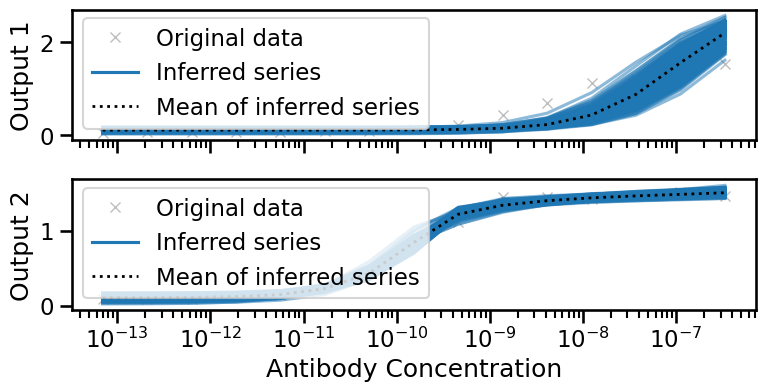

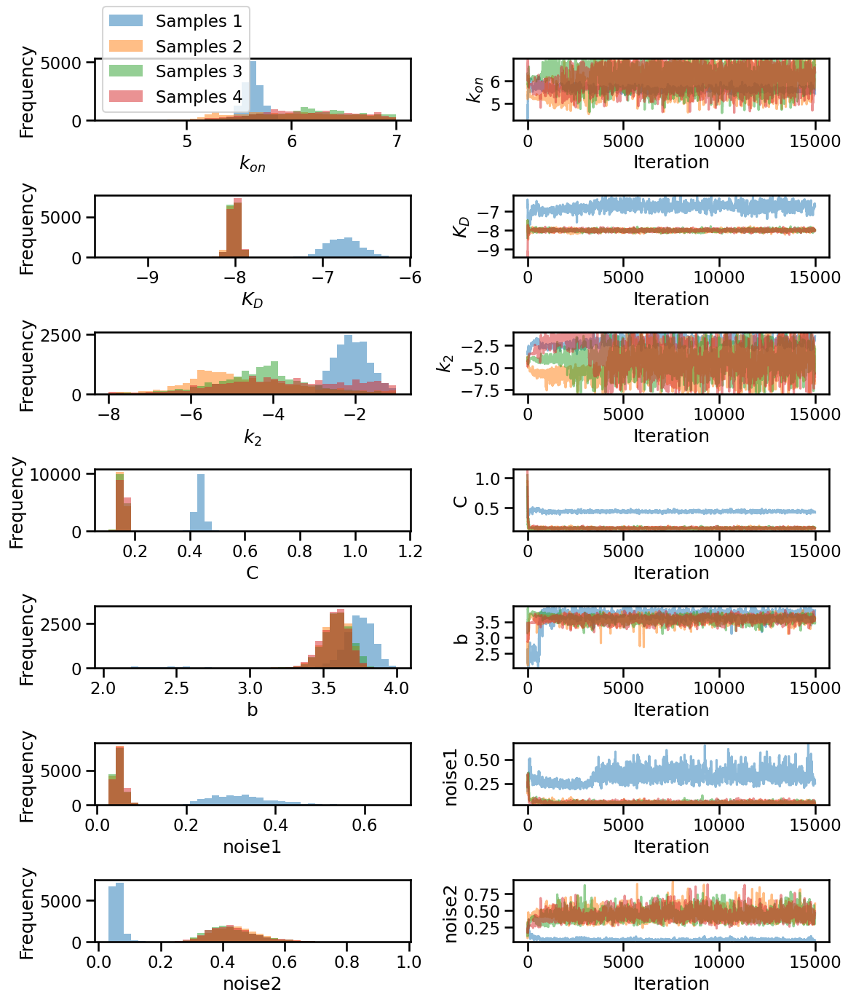

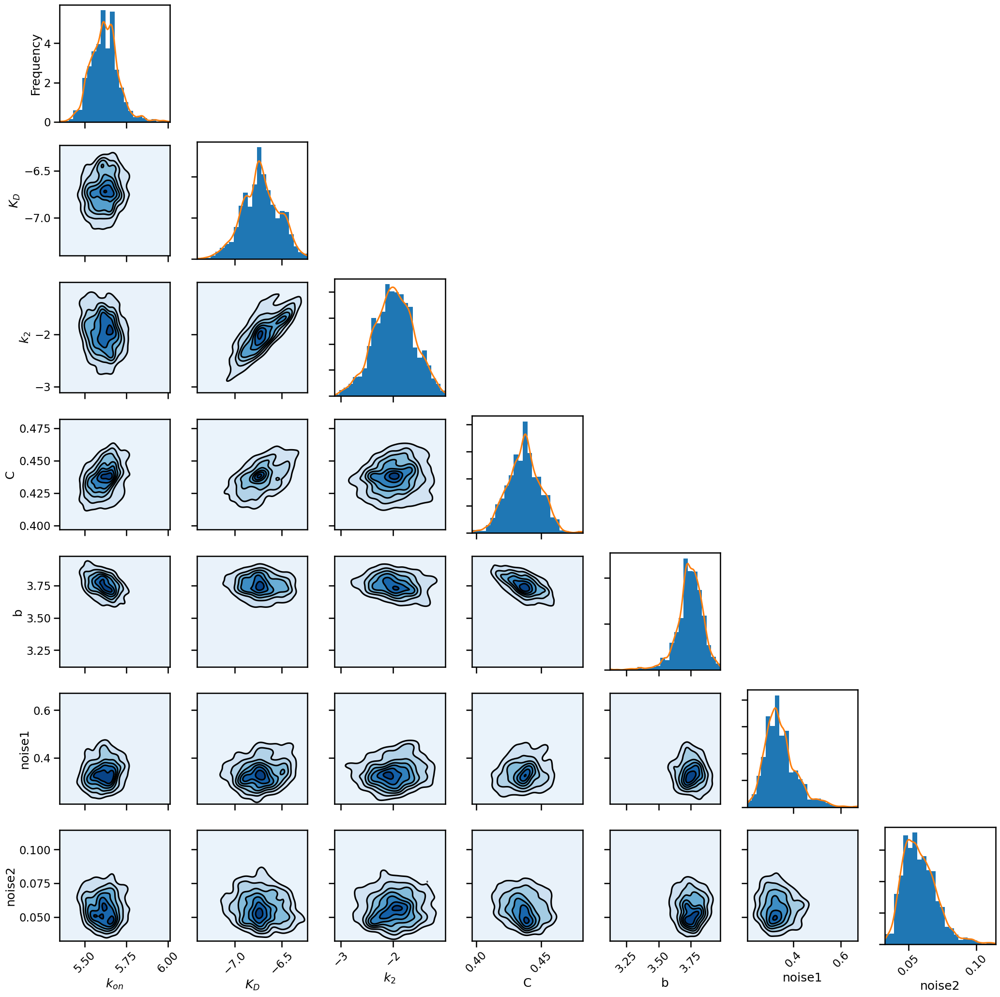

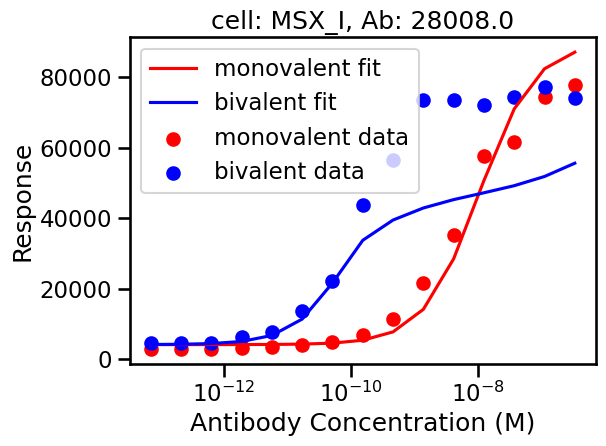

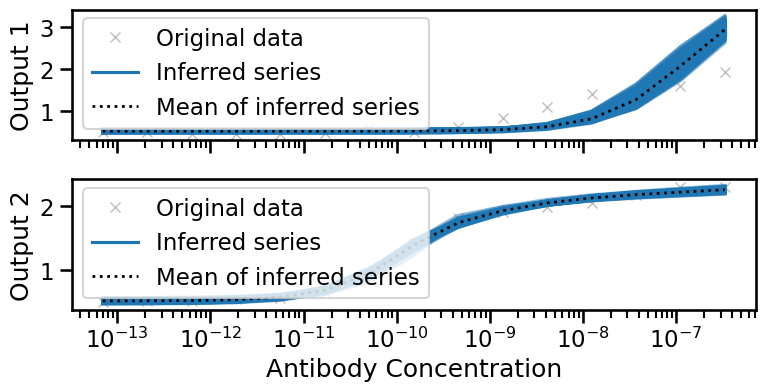

...

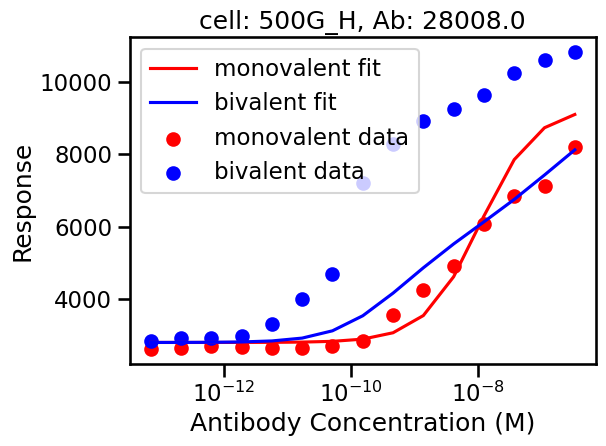

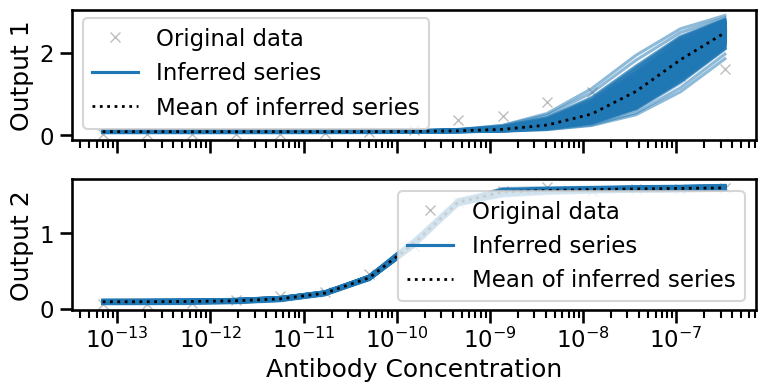

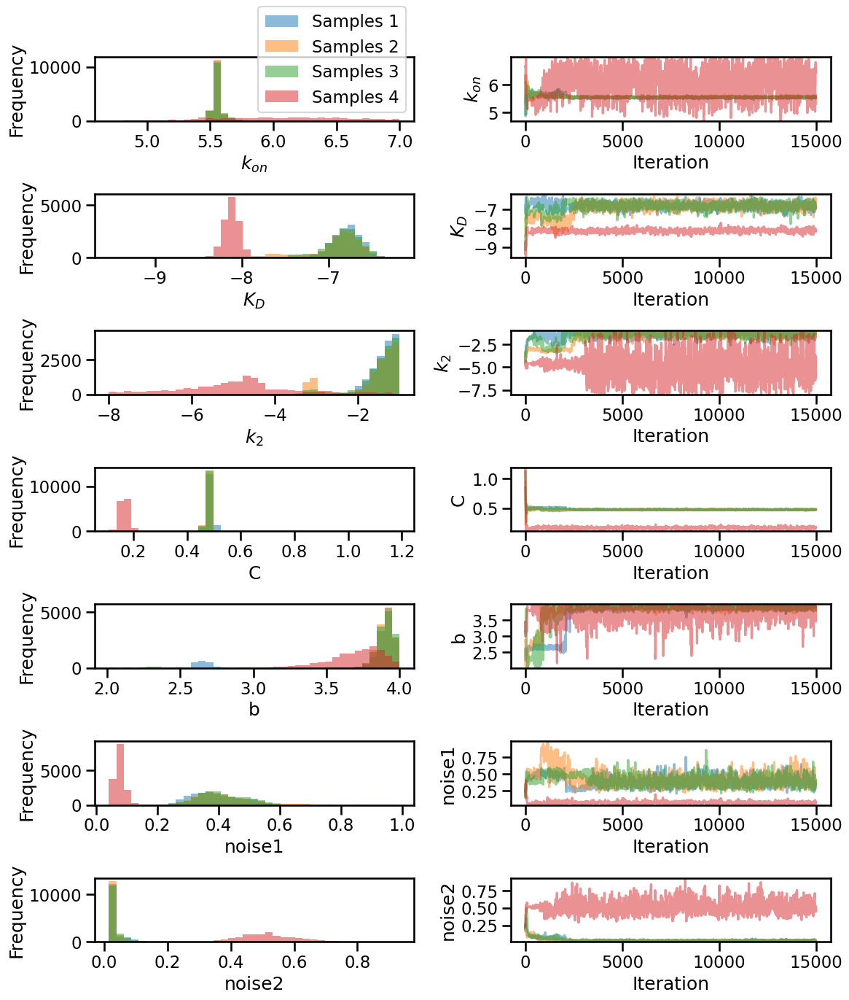

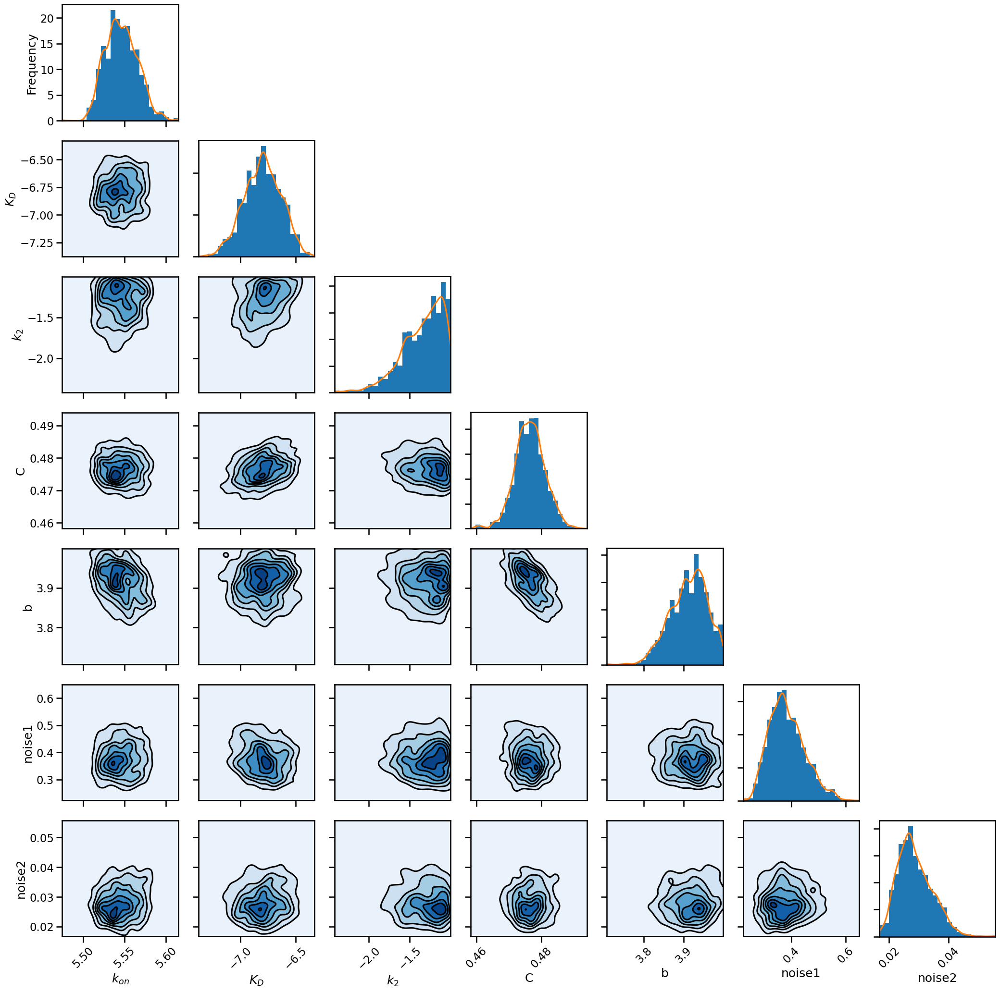

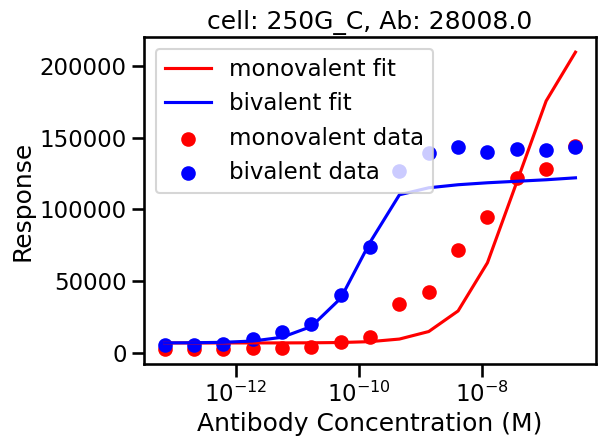

In [56]:
cell_ids = list(set(df['CELL_ID'].values))
cell_ids.remove('CHO Parent')
antibody_ids1 = list(set(df['ANTIBODY_ID'].values))
antibody_ids = [x for x in antibody_ids1 if str(x) != 'nan']
if 'RSV' in antibody_ids:
    antibody_ids.remove('RSV')
antibody_ids.remove(28015)
monos = []
bivs = []
concs = []

for cell_id in cell_ids:
    print(cell_id)
    for antibody_id in antibody_ids:
        mono, biv, conc = data_extractor(df, cell_id, antibody_id)
        #remove last data point due to peak effect
        mono = np.array(mono[:-1])
        biv = np.array(biv[:-1])
        conc = np.array(conc[:-1])
        monos.append(mono)
        bivs.append(biv)
        concs.append(conc)
        rtot = receptor_quant[cell_id] - 2000
        print(receptor_quant[cell_id])
        data = np.stack((mono, biv), axis=1)
        max = np.max(data)
        data = (data)/rtot
        
        chain_results, results = mcmc_alg(cell_id, antibody_id, conc, mono, biv)
        
        #plot chains
        parameter_names=[r'$k_{on}$', r'$K_D$', r'$k_2$', 'C', 'b', 'noise1', 'noise2']
        pints.plot.trace(chain_results, parameter_names=parameter_names) 
        name = str(cell_id) + str(antibody_id)
        chains_filename = '/Users/lukeheirene/ADCC-Project/GSK_mono_biv_project/Plots_med_aff_bg/chains_%s.png' % name
        plt.tight_layout()
        plt.savefig(chains_filename)


        chain = chain_results[0]
        chain = chain[10000:]
        chains1 = chain_results[:, 10000 :]
        pints.plot.pairwise(chain, kde=True,  parameter_names=parameter_names)
        posteriors_filename = '/Users/lukeheirene/ADCC-Project/GSK_mono_biv_project/Plots_med_aff_bg/posteriors_%s.png' % name
        plt.tight_layout()
        plt.savefig(posteriors_filename)

        results_list = results._summary_list
        results_dic = {}
        means =[]
        stds = []
        l_perc = []
        h_perc = []
        rhats = []
        parameter_names1=[r'$k_{on}$', r'$K_D$', r'$k_2$', 'C', 'b']
        for i, param in enumerate(parameter_names1):
            holder = results_list[i]
            means.append(holder[1])
            stds.append(holder[2])
            l_perc.append(holder[3])
            h_perc.append(holder[7])
            rhats.append(holder[8])

        results_dic['parameter'] = parameter_names1
        results_dic['mean'] = means
        results_dic['std'] = stds
        results_dic['2.5%'] = l_perc
        results_dic['97.5%'] = h_perc
        results_dic['rhat'] = rhats

        df_new = pd.DataFrame(results_dic)
        csv_name = posteriors_filename = '/Users/lukeheirene/ADCC-Project/GSK_mono_biv_project/results_med_aff_bg/results_%s.csv' % name
        df_new.to_csv(csv_name)

        sim = simulate_model(conc, results_dic['mean'], rtot)
        fig, ax = plt.subplots()
        ax.semilogx(conc, sim[:, 0], label='monovalent fit', c='red')
        ax.semilogx(conc, sim[:, 1], label = 'bivalent fit', c='blue')
        ax.scatter(conc, mono, label='monovalent data', c='red')
        ax.scatter(conc, biv, label='bivalent data', c='blue')
        ax.legend(loc='best')
        ax.set_ylabel('Response')
        ax.set_xlabel('Antibody Concentration (M)')
        ax.set_title('cell: ' + str(cell_id) + ', ' + 'Ab: ' + str(antibody_id))
        filename = '/Users/lukeheirene/ADCC-Project/GSK_mono_biv_project/Plots_med_aff_bg/fitting_results%s.png' % name
        fig.tight_layout()
        fig.savefig(filename)
